# Quantum Support Vector Classifier (QSVC) Training

This notebook will train a QSVC on the Pima Indians Diabetes dataset based on best parameters found

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

### Imports

In [3]:
# imports
from matplotlib import pyplot as plt
import seaborn as sns

import numpy as np

import os
import time

# import data class
from utilities.dataset_utils import DiabetesData

# sampling for dataset imbalance
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.utils import shuffle

# import metrics for evaluation
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

# qiskit imports
# circuit transpiler
from qiskit import transpile

# algorithm
from qiskit_machine_learning.algorithms import QSVC

# feature map
from qiskit.circuit.library import z_feature_map

# fidelity
from qiskit_machine_learning.state_fidelities import ComputeUncompute

# kernel
from qiskit_machine_learning.kernels import FidelityQuantumKernel

# simulator
from qiskit_aer import AerSimulator
from qiskit_aer.primitives import SamplerV2 as Sampler

In [4]:
# path to diabetes.csv
path = os.path.join(os.getcwd(), '..', '..', '..', 'utilities', 'diabetes.csv')
# load dataset class
dataset = DiabetesData(path)

In [5]:
# setup backend simulator
backend = AerSimulator()
backend.set_options(max_parallel_threads=os.cpu_count(), method='statevector')

In [6]:
# feature map
feature_map = z_feature_map(feature_dimension=dataset.get_num_features(), reps=2, entanglement='linear')

feature_map = transpile(feature_map, backend=backend, optimization_level=3) # transpile to backend

In [7]:
# sampler
sampler = Sampler.from_backend(backend)

In [8]:
# fidelity
fidelity = ComputeUncompute(sampler=sampler)

In [9]:
# kernel
kernel = FidelityQuantumKernel(
    feature_map=feature_map,
    fidelity=fidelity,
    max_circuits_per_job=50000 # adjust max circuits based on hardware
)
# ran on laptop with AMD Ryzen 7 8840HS (8-core) and 16GB RAM

In [10]:
# create the QSVC instance
qsvc = QSVC(
    quantum_kernel=kernel,
    C=1,
    max_iter=1000
)

### Iterative Kernel Evaluation Function

In [11]:
def iterative_kernel_eval(kernel, X):
    """
    Iteratively evaluate kernel matrix
    """
    # get number of samples
    n_samples = X.shape[0]
    
    # initialize kernel matrix
    K = np.zeros((n_samples, n_samples))
    
    # iterate over all samples
    for i in range(n_samples):
        for j in range(n_samples):
            val = kernel.evaluate(np.array([X[i]]), np.array([X[j]]))[0, 0]
            K[i, j] = val
            print(f"Kernel val for pair ({i}, {j}): {val}")
    return K

### Model Fit on Simulator

In [12]:
# get training and testing data
X_train, X_test, y_train, y_test = dataset.preprocess_data_ranged()

In [13]:
print(Counter(y_train))

Counter({np.int64(0): 350, np.int64(1): 187})


In [14]:
smote = SMOTE(random_state=42)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train, y_train)
X_train_balanced, y_train_balanced = shuffle(X_train_balanced, y_train_balanced, random_state=42)

In [15]:
print(Counter(y_train_balanced))

Counter({np.int64(1): 350, np.int64(0): 350})


In [15]:
# evaluate kernel matrix
kernel_matrix_train = iterative_kernel_eval(kernel, X_train_balanced)

Kernel val for pair (0, 0): 1.0
Kernel val for pair (0, 1): 0.0341796875
Kernel val for pair (0, 2): 0.1982421875
Kernel val for pair (0, 3): 0.3232421875
Kernel val for pair (0, 4): 0.298828125
Kernel val for pair (0, 5): 0.0927734375
Kernel val for pair (0, 6): 0.2890625
Kernel val for pair (0, 7): 0.2900390625
Kernel val for pair (0, 8): 0.05859375
Kernel val for pair (0, 9): 0.05078125
Kernel val for pair (0, 10): 0.25390625
Kernel val for pair (0, 11): 0.2392578125
Kernel val for pair (0, 12): 0.240234375
Kernel val for pair (0, 13): 0.203125
Kernel val for pair (0, 14): 0.01171875
Kernel val for pair (0, 15): 0.1025390625
Kernel val for pair (0, 16): 0.046875
Kernel val for pair (0, 17): 0.1650390625
Kernel val for pair (0, 18): 0.2646484375
Kernel val for pair (0, 19): 0.3427734375
Kernel val for pair (0, 20): 0.1875
Kernel val for pair (0, 21): 0.2578125
Kernel val for pair (0, 22): 0.2626953125
Kernel val for pair (0, 23): 0.2197265625
Kernel val for pair (0, 24): 0.189453125


In [16]:
# time how long it takes to train
start = time.time()

# fit the model
qsvc = qsvc.fit(X_train, y_train)

end = time.time()
elapsed = end - start

# print training time
print(f"Training Time: {round(elapsed)} secs")

Training Time: 16561 secs


### Save Model

In [17]:
# path to save model
model_path = os.path.join(os.getcwd(), '..', '..', '..', 'models', 'qml-simulator')

# create model directory if it doesn't exist
os.makedirs(model_path, exist_ok=True)

# create model file
model_file = os.path.join(model_path, 'qsvc_best_params.model')

# save model
qsvc.save(model_file)
print(f'Model saved to {model_file}')

Model saved to /home/barra-white/college/qml-explainability-by-parts/training/qml-best-params/qsvc/../../../models/qml-simulator/qsvc_best_params.model


### QSVC Evaluation

In [17]:
# path to diabetes.csv
path = os.path.join(os.getcwd(), '..', '..', '..', 'models', 'qml-simulator', 'qsvc_best_params.model')

qsvc = QSVC.load(path)

In [18]:
train_score = qsvc.score(X_train, y_train)
test_score = qsvc.score(X_test, y_test)
train_score, test_score

(0.8379888268156425, 0.7489177489177489)

In [18]:
batch_size = 10
total_samples = len(X_test)
y_pred_batches = []

for i in range(0, total_samples, batch_size):
    batch = X_test[i:i+batch_size]
    y_pred_batches.append(qsvc.predict(batch))
    
    # Calculate progress
    processed = min(i + batch_size, total_samples)
    remaining = total_samples - processed
    progress = (processed / total_samples) * 100
    
    print(f"Processed {processed}/{total_samples} samples ({progress:.2f}%). Remaining: {remaining}")

y_pred = np.concatenate(y_pred_batches)
print("Prediction complete!")

Processed 10/231 samples (4.33%). Remaining: 221
Processed 20/231 samples (8.66%). Remaining: 211
Processed 30/231 samples (12.99%). Remaining: 201
Processed 40/231 samples (17.32%). Remaining: 191
Processed 50/231 samples (21.65%). Remaining: 181
Processed 60/231 samples (25.97%). Remaining: 171
Processed 70/231 samples (30.30%). Remaining: 161
Processed 80/231 samples (34.63%). Remaining: 151
Processed 90/231 samples (38.96%). Remaining: 141
Processed 100/231 samples (43.29%). Remaining: 131
Processed 110/231 samples (47.62%). Remaining: 121
Processed 120/231 samples (51.95%). Remaining: 111
Processed 130/231 samples (56.28%). Remaining: 101
Processed 140/231 samples (60.61%). Remaining: 91
Processed 150/231 samples (64.94%). Remaining: 81
Processed 160/231 samples (69.26%). Remaining: 71
Processed 170/231 samples (73.59%). Remaining: 61
Processed 180/231 samples (77.92%). Remaining: 51
Processed 190/231 samples (82.25%). Remaining: 41
Processed 200/231 samples (86.58%). Remaining: 3

In [19]:
# confusion matrix
def conf_matrix(y_test, y_pred):
    cm = confusion_matrix(y_test, y_pred)
    heatmap = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
    plt.title('Confusion Matrix: QSVC')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

In [20]:
# accuracy score
accuracy = accuracy_score(y_test, y_pred)

In [21]:
# classification report
report = classification_report(y_test, y_pred, zero_division=0, output_dict=False)

Accuracy: 0.7402597402597403
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.84      0.81       150
           1       0.65      0.56      0.60        81

    accuracy                           0.74       231
   macro avg       0.71      0.70      0.70       231
weighted avg       0.73      0.74      0.73       231



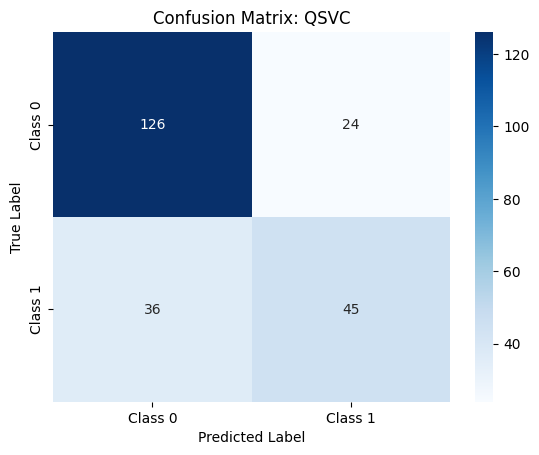

In [22]:
# print metrics
print(f'Accuracy: {accuracy}')
print(f'Classification Report:\n{report}')
conf_matrix(y_test, y_pred)